In [135]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [136]:
train=pd.read_csv("Binary Prediction of Smoker Status using Bio-Signals/train.csv")

In [137]:
train.head()

,id,age,height_cm,weight_kg,waist_cm,eyesight_left,eyesight_right,hearing_left,hearing_right,systolic,...,HDL,LDL,hemoglobin,Urine_protein,serum_creatinine,AST,ALT,Gtp,dental_caries,smoking
0,0,55,165,60,81.0,0.5,0.6,1,1,135,...,40,75,16.5,1,1.0,22,25,27,0,1
1,1,70,165,65,89.0,0.6,0.7,2,2,146,...,57,126,16.2,1,1.1,27,23,37,1,0
2,2,20,170,75,81.0,0.4,0.5,1,1,118,...,45,93,17.4,1,0.8,27,31,53,0,1
3,3,35,180,95,105.0,1.5,1.2,1,1,131,...,38,102,15.9,1,1.0,20,27,30,1,0
4,4,30,165,60,80.5,1.5,1.0,1,1,121,...,44,93,15.4,1,0.8,19,13,17,0,1


In [138]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159256 entries, 0 to 159255
Data columns (total 24 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   159256 non-null  int64  
 1   age                  159256 non-null  int64  
 2   height_cm            159256 non-null  int64  
 3   weight_kg            159256 non-null  int64  
 4   waist_cm             159256 non-null  float64
 5   eyesight_left        159256 non-null  float64
 6   eyesight_right       159256 non-null  float64
 7   hearing_left         159256 non-null  int64  
 8   hearing_right        159256 non-null  int64  
 9   systolic             159256 non-null  int64  
 10  relaxation           159256 non-null  int64  
 11  fasting_blood_sugar  159256 non-null  int64  
 12  Cholesterol          159256 non-null  int64  
 13  triglyceride         159256 non-null  int64  
 14  HDL                  159256 non-null  int64  
 15  LDL              

In [139]:
col_rename={
    'fasting blood sugar':'fasting_blood_sugar',
    'Urine protein':'Urine_protein',
    'serum creatinine':'serum_creatinine',
    'dental caries':'dental_caries'   
}

In [140]:
## Putting _ in 4 col
train.rename(columns=col_rename,inplace=True)

In [141]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159256 entries, 0 to 159255
Data columns (total 24 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   159256 non-null  int64  
 1   age                  159256 non-null  int64  
 2   height_cm            159256 non-null  int64  
 3   weight_kg            159256 non-null  int64  
 4   waist_cm             159256 non-null  float64
 5   eyesight_left        159256 non-null  float64
 6   eyesight_right       159256 non-null  float64
 7   hearing_left         159256 non-null  int64  
 8   hearing_right        159256 non-null  int64  
 9   systolic             159256 non-null  int64  
 10  relaxation           159256 non-null  int64  
 11  fasting_blood_sugar  159256 non-null  int64  
 12  Cholesterol          159256 non-null  int64  
 13  triglyceride         159256 non-null  int64  
 14  HDL                  159256 non-null  int64  
 15  LDL              

In [142]:
train.shape

(159256, 24)

In [143]:
new_train=train.copy()

## NULL VALUE

In [144]:
train.isnull().sum()

id                     0
age                    0
height_cm              0
weight_kg              0
waist_cm               0
eyesight_left          0
eyesight_right         0
hearing_left           0
hearing_right          0
systolic               0
relaxation             0
fasting_blood_sugar    0
Cholesterol            0
triglyceride           0
HDL                    0
LDL                    0
hemoglobin             0
Urine_protein          0
serum_creatinine       0
AST                    0
ALT                    0
Gtp                    0
dental_caries          0
smoking                0
dtype: int64

<h4 style="color:#333333;""><span style="background-color: #e6e6fa; display: inline-block; padding: 5px;"">NO NULL VALUE</span></h4>

# EDA

#### AGE

In [145]:
train['age'].value_counts()

age
40    46691
60    19043
45    18480
50    15768
55    13446
35    13081
30    11465
25     9140
20     3829
65     3637
70     2229
75     1760
80      644
85       38
58        2
62        1
69        1
49        1
Name: count, dtype: int64

In [146]:
def categorize_age(age):
    if 0 <= age <= 9:
        return 'Child'
    elif 10 <= age <= 19:
        return 'Adolescent'
    elif 20 <= age <= 35:
        return 'Young Adult'
    elif 36 <= age <= 45:
        return 'Middle-Aged Adult'
    elif 46 <= age <= 60:
        return 'Senior Adult'
    elif age > 60:
        return 'Senior Citizen'
    else:
        return 'Unknown'

In [147]:
train['age']=train['age'].apply(lambda x:categorize_age(x))

In [148]:
train['age'].value_counts()

age
Middle-Aged Adult    65171
Senior Adult         48260
Young Adult          37515
Senior Citizen        8310
Name: count, dtype: int64

#### Height and Weight

In [152]:
train['height_cm'].value_counts()

height_cm
170    37398
165    30145
175    24852
160    22783
155    19597
150    11534
180     8185
145     2736
185     1562
140      410
190       44
135        8
181        1
139        1
Name: count, dtype: int64

In [153]:
train['weight_kg'].value_counts()

weight_kg
70     24168
65     23069
60     21658
75     19698
55     18715
50     13780
80     13631
85      8612
45      5420
90      4676
95      2647
100     1391
40       881
105      500
110      228
115       82
35        47
120       24
30        14
125        6
130        2
101        1
89         1
82         1
83         1
99         1
79         1
88         1
Name: count, dtype: int64

##### The height-to-weight ratio, also known as Body Mass Index (BMI)   
##### The World Health Organization (WHO) provides the following categories for BMI:

- Underweight: BMI < 18.5
- Normal weight: BMI 18.5 - 24.9
- Overweight: BMI 25 - 29.9
- Obese: BMI ≥ 30

In [154]:
def BMI(height,weight):
    m=height/100
    val=(weight/m**2)
    val=round(val,1)
    if val<18.5:
        return 'Underweight'
    elif 18.5 <= val <= 24.9:
        return 'Normal weight'
    elif 25 <= val <= 29.9:
        return 'Overweight'
    elif val >= 30:
        return 'Obese'
    else:
        return 'unknown'

In [155]:
BMI(176,47)

'Underweight'

In [156]:
train['BMI']=train[['height_cm','weight_kg']].apply(lambda x:BMI(x['height_cm'],x['weight_kg']),axis=1)

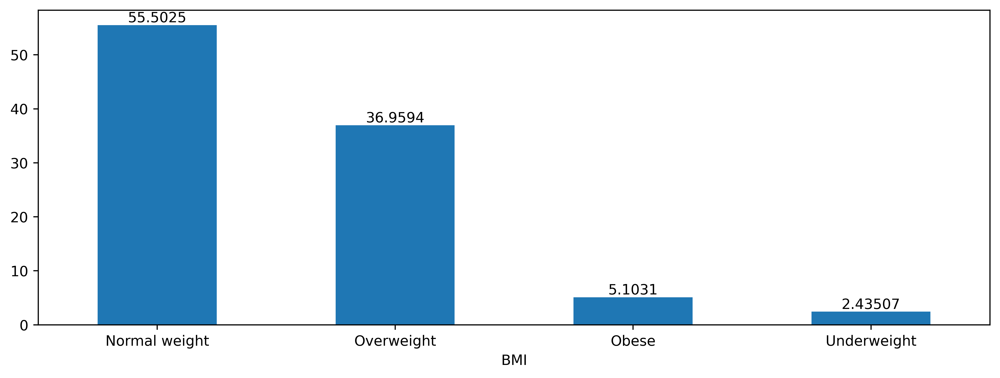

In [157]:
plt.figure(figsize=(12,4),dpi=500)
ax=((train['BMI'].value_counts()/train.shape[0])*100).plot(kind='bar')
plt.xticks(rotation=0) 
for i in ax.containers:
    ax.bar_label(i,)

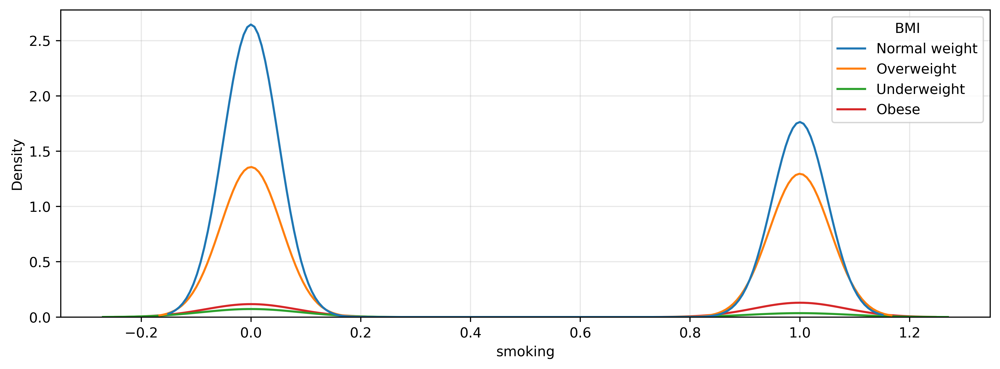

In [158]:
plt.figure(figsize=(12,4),dpi=500)
sns.kdeplot(x=train['smoking'],hue=train['BMI'])
plt.grid(alpha=0.3)

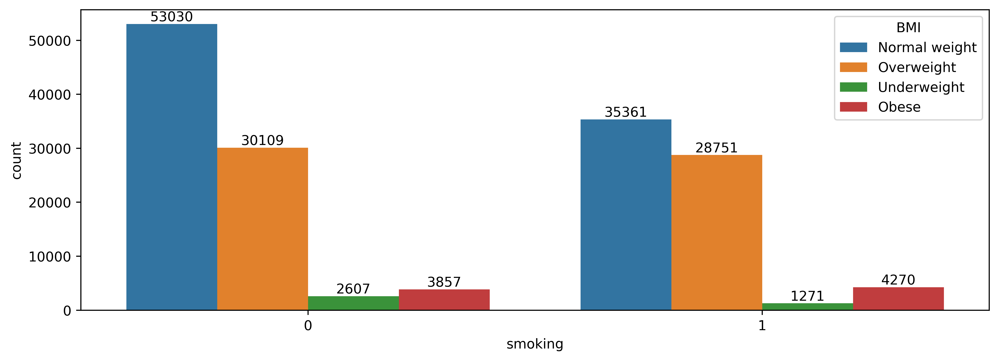

In [159]:
plt.figure(figsize=(12,4),dpi=500)
ax=sns.countplot(x=train['smoking'],hue=train['BMI'])
for i in ax.containers:
    ax.bar_label(i,)

### eyesight

In [160]:
print(train['eyesight_right'].max(),train['eyesight_left'].max())
print(train['eyesight_right'].min(),train['eyesight_left'].min())

9.9 9.9
0.1 0.1


In [161]:
def eye(x,y):
    return ((x+y)/2).round(1)

In [163]:
train['eyesight']=train[['eyesight_right','eyesight_left']].apply(lambda x:eye(x['eyesight_left'],x['eyesight_right']),axis=1)

In [164]:
train['eyesight'].value_counts()

eyesight
1.0    31663
0.8    22387
1.2    22107
1.1    19608
0.6    12465
1.5    12019
1.4    11736
0.9    11289
0.7     5655
0.4     4612
0.5     2663
0.2      995
0.3      729
1.8      646
0.1      168
2.0      160
1.6      102
5.4       97
5.2       34
5.6       30
5.3       27
5.7       26
5.0       16
1.3       11
9.9        8
5.1        3
Name: count, dtype: int64

<Axes: xlabel='eyesight_left'>

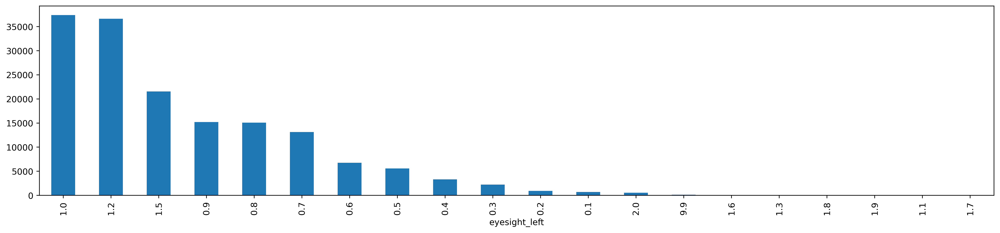

In [166]:
plt.figure(figsize=(20,4),dpi=400)
train["eyesight_left"].value_counts().nlargest(20).plot(kind='bar')

<Axes: xlabel='eyesight_left'>

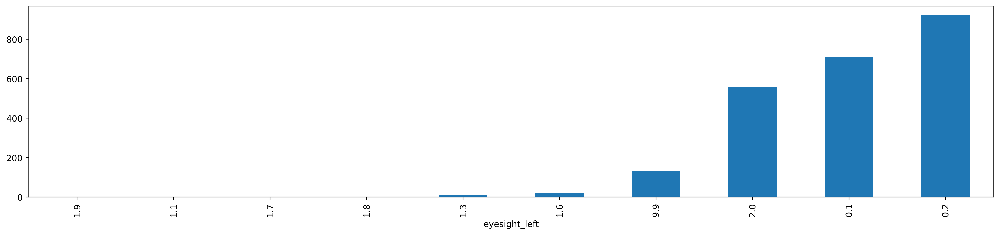

In [167]:
plt.figure(figsize=(20,4),dpi=400)
train["eyesight_left"].value_counts().nsmallest(10).plot(kind='bar')

<Axes: xlabel='eyesight_right'>

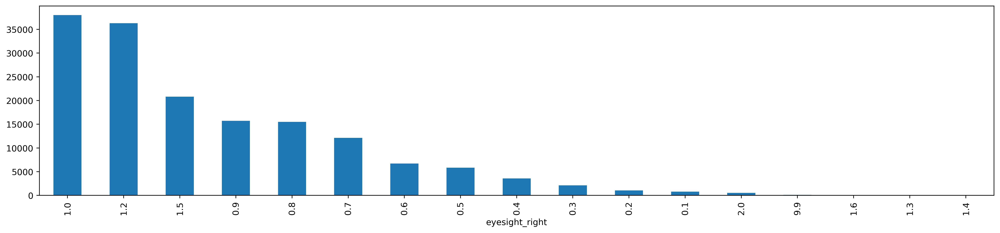

In [168]:
plt.figure(figsize=(20,4),dpi=400)
train["eyesight_right"].value_counts().nlargest(20).plot(kind='bar')

### Hearing

In [169]:
print(train['hearing_right'].max(),train['hearing_left'].max())
print(train['hearing_right'].min(),train['hearing_left'].min())

2 2
1 1


In [170]:
train['hearing']=train[['hearing_left','hearing_right']].apply(lambda x:eye(x['hearing_left'],x['hearing_right']),axis=1)

In [171]:
train['hearing'].value_counts()

hearing
1.0    153836
1.5      3292
2.0      2128
Name: count, dtype: int64

## Smoking

In [172]:
print(train['smoking'].value_counts())
print("-"*25)
print((train['smoking'].value_counts()/train.shape[0])*100)

smoking
0    89603
1    69653
Name: count, dtype: int64
-------------------------
smoking
0    56.2635
1    43.7365
Name: count, dtype: float64


<h4 style="color:#333333;""><span style="background-color: #e6e6fa; display: inline-block; padding: 5px;"">Balanced Datset</span></h4>


## Features W.R.T Label Columns

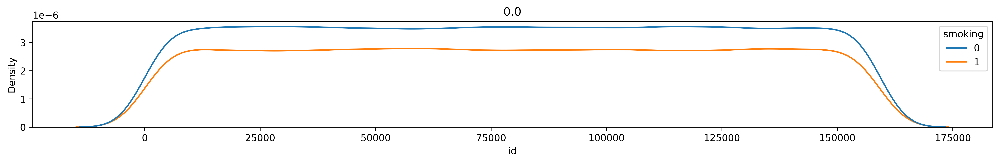

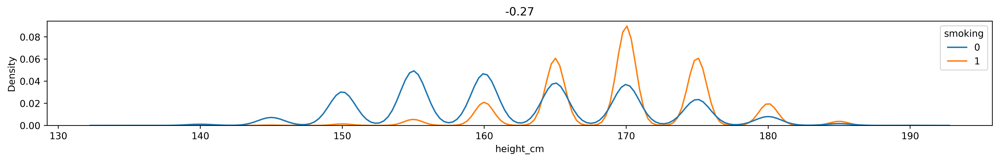

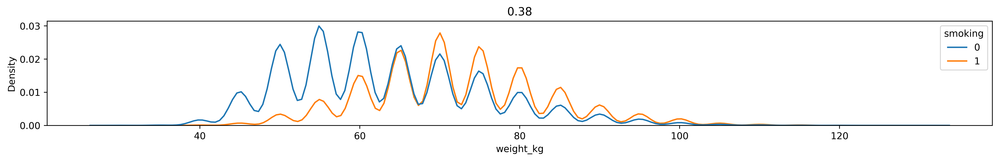

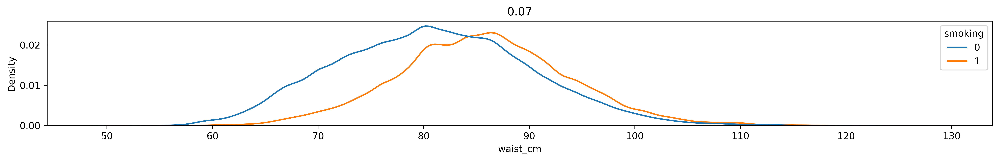

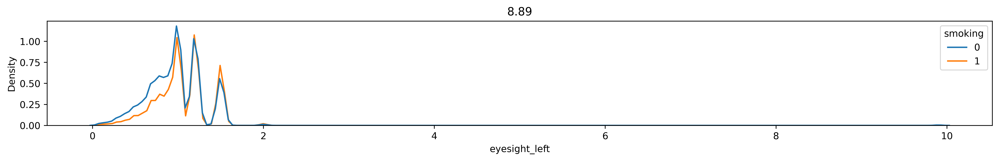

...

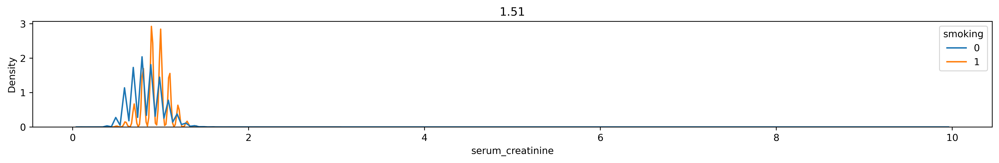

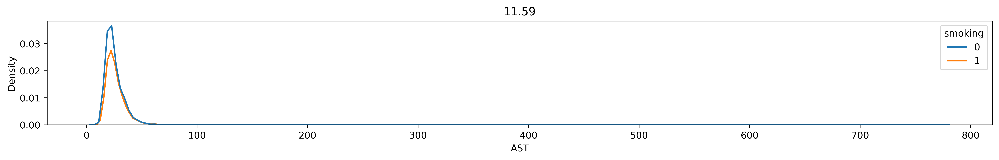

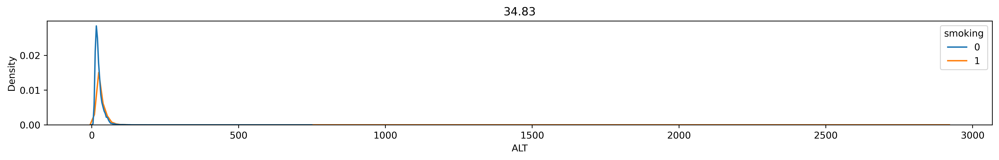

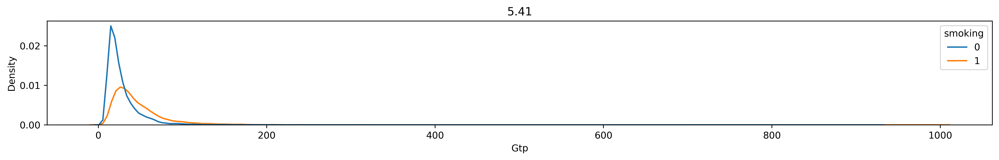

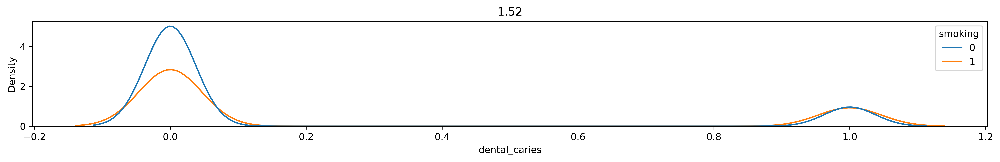

C:\Users\KIIT\AppData\Local\Temp\ipykernel_8268\4060486310.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(x=train[i],color='pink',hue=train['smoking'])


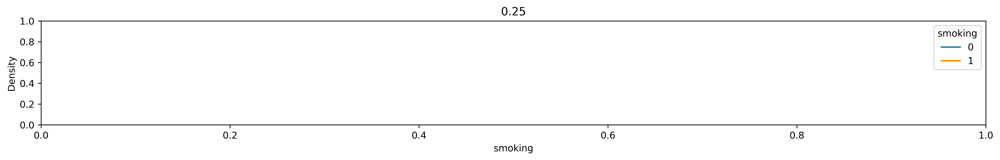

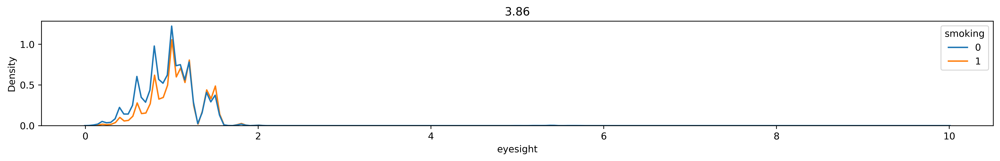

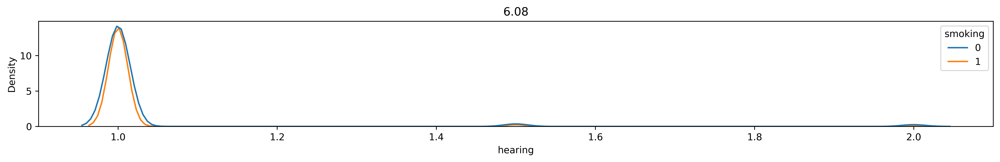

In [173]:
for i in train.select_dtypes(include=['number']):
    plt.figure(figsize=(18,2),dpi=500)
    sns.kdeplot(x=train[i],color='pink',hue=train['smoking'])
    plt.title(train[i].skew().round(2))
    plt.show()

## Co-relation

In [174]:
cor=train.corr(numeric_only=True)

<Axes: >

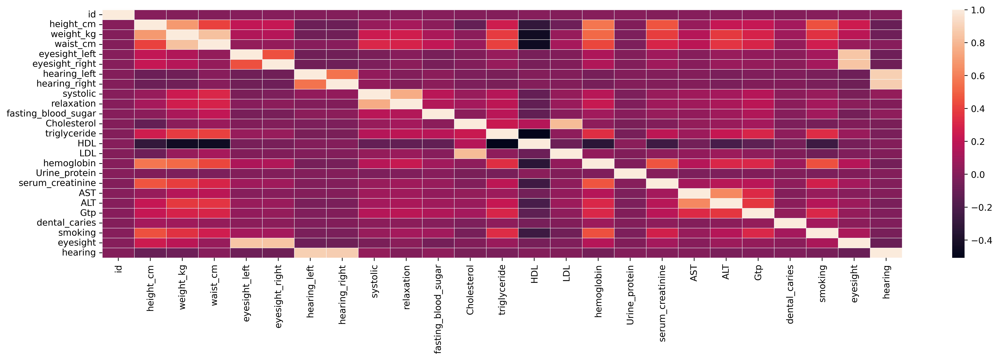

In [175]:
plt.figure(figsize=(20,5),dpi=500)
sns.heatmap(cor,linecolor='white',linewidths=0.2)

### Correlation w.r.t smoking col which is a label 

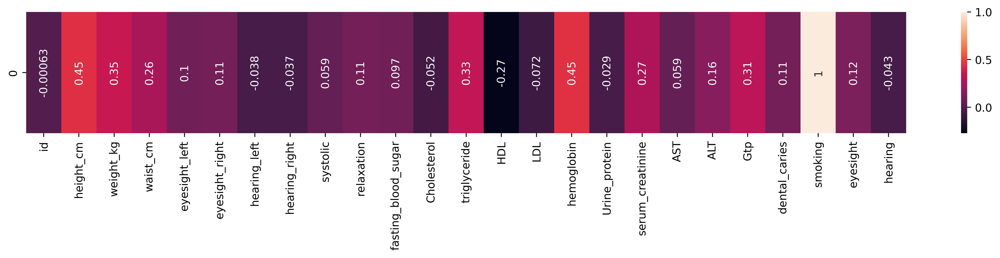

In [176]:
plt.figure(figsize=(18,2),dpi=500)
corr=train.corrwith(train["smoking"],numeric_only=True)
corr=corr.to_frame().T
sns.heatmap(corr,annot=True,annot_kws={"rotation": 90})
plt.show()

## Outlier detection 

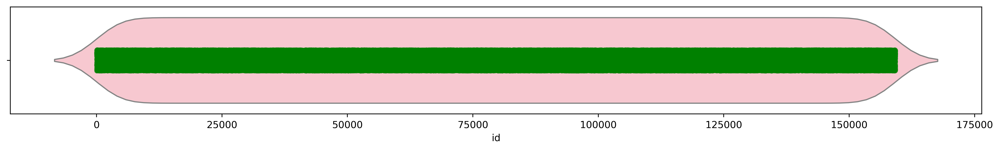

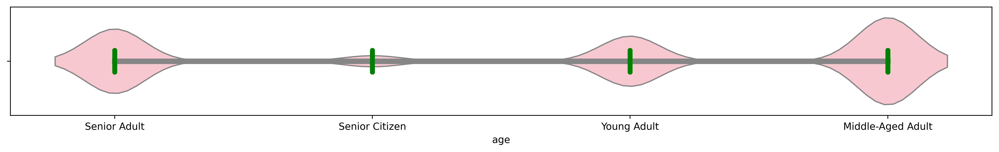

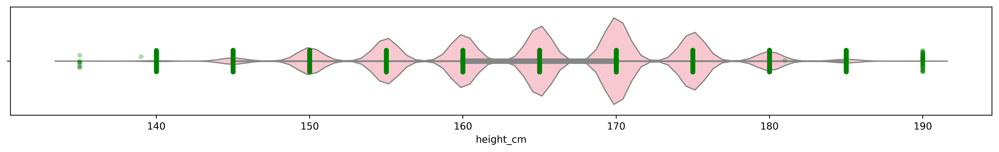

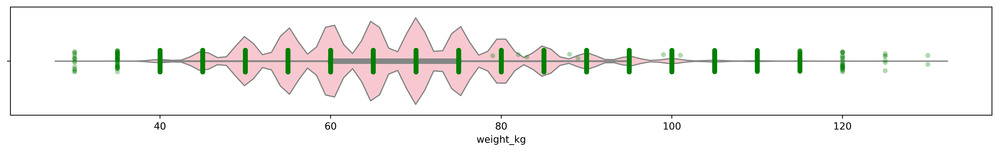

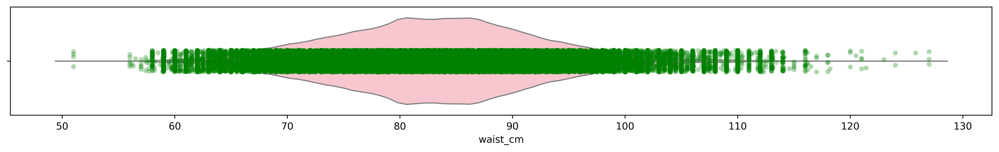

...

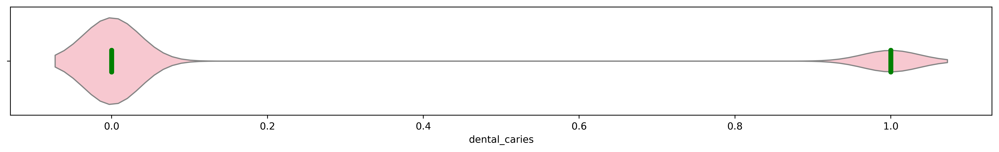

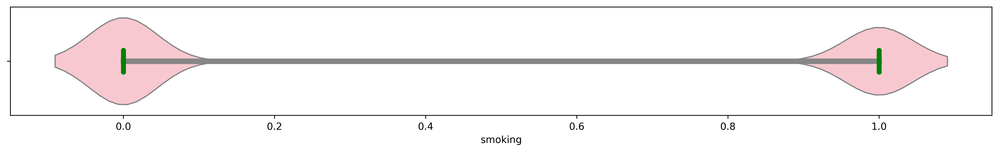

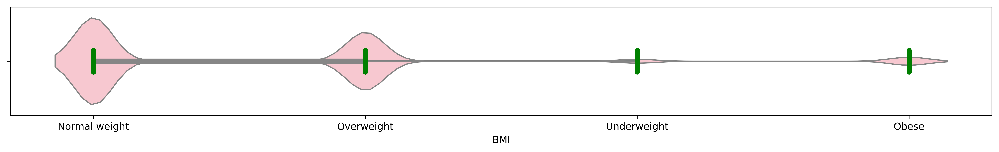

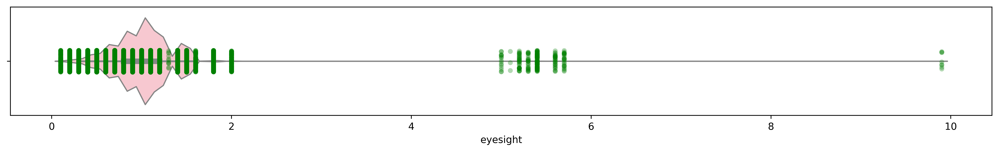

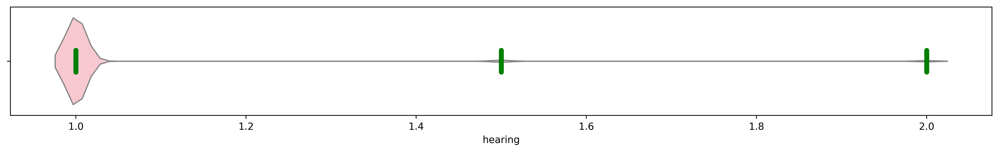

In [177]:
for i in train.columns:
    plt.figure(figsize=(18,2),dpi=500)
    sns.violinplot(x=train[i],color='pink')
    sns.stripplot(x=train[i],color='green',alpha=0.3)
    plt.show()

In [178]:
heat=train.skew(numeric_only=True).to_frame().T

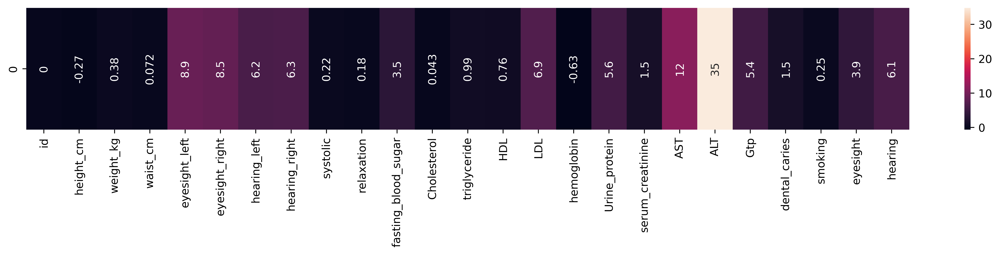

In [179]:
plt.figure(figsize=(18,2),dpi=500)
sns.heatmap(heat,annot=True,annot_kws={"rotation": 90})
plt.show()

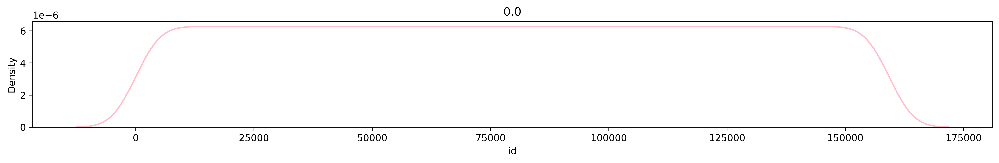

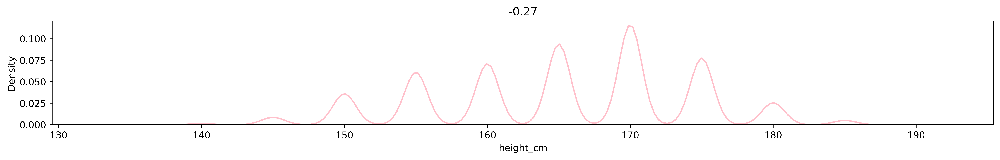

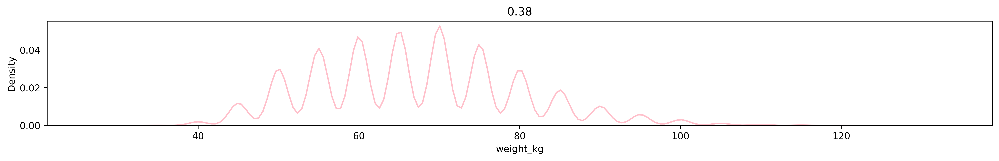

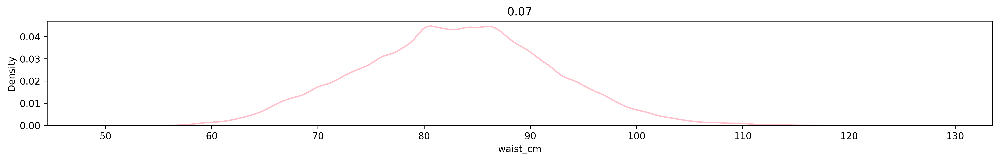

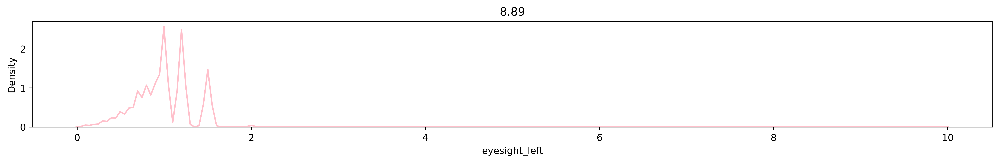

...

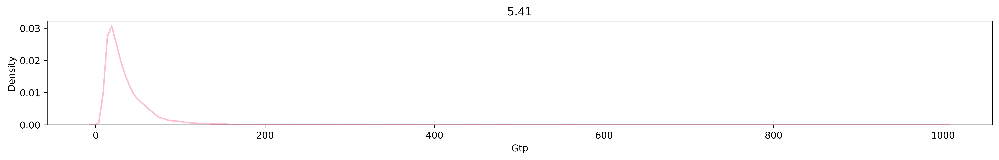

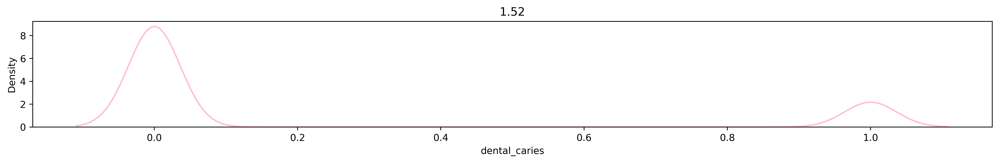

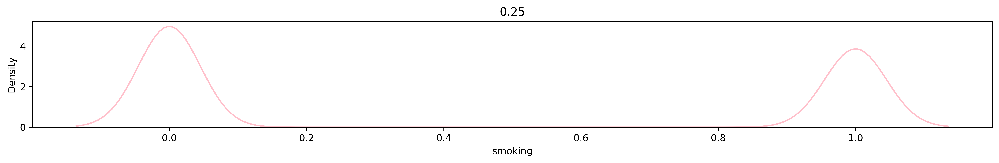

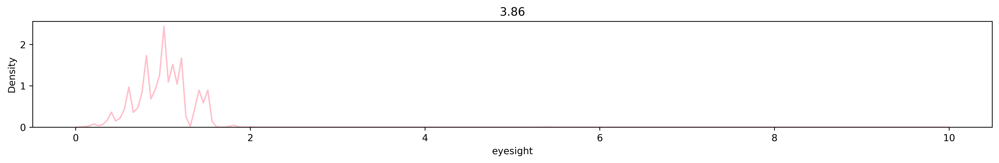

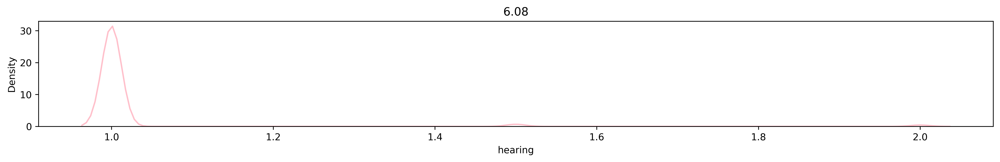

In [180]:
for i in train.select_dtypes(include=['number']):
    plt.figure(figsize=(18,2),dpi=500)
    sns.kdeplot(x=train[i],color='pink')
    plt.title(train[i].skew().round(2))
    plt.show()

OUTCOME:->    
{'eyesight','hearing','fasting blood sugar','LDL','Urine protein','AST','ALT','Gtp}    
These Col has high skew value.

In [181]:
train.columns

Index(['id', 'age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left',
       'eyesight_right', 'hearing_left', 'hearing_right', 'systolic',
       'relaxation', 'fasting_blood_sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine_protein', 'serum_creatinine', 'AST',
       'ALT', 'Gtp', 'dental_caries', 'smoking', 'BMI', 'eyesight', 'hearing'],
      dtype='object')

# MODEL

In [182]:
train.columns

Index(['id', 'age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left',
       'eyesight_right', 'hearing_left', 'hearing_right', 'systolic',
       'relaxation', 'fasting_blood_sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine_protein', 'serum_creatinine', 'AST',
       'ALT', 'Gtp', 'dental_caries', 'smoking', 'BMI', 'eyesight', 'hearing'],
      dtype='object')

In [183]:
num_with_outlier=[ 'eyesight','hearing','fasting_blood_sugar','LDL','Urine_protein','AST','ALT','Gtp']
num_without_outlier=['systolic','relaxation','Cholesterol','triglyceride','HDL','hemoglobin','serum_creatinine','dental_caries']
cat=['age','BMI']

In [184]:
x=train.drop(['id','smoking'],axis=1)
y=train['smoking']

In [185]:
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn.compose import ColumnTransformer,make_column_transformer
from sklearn.preprocessing import OneHotEncoder,StandardScaler,FunctionTransformer,OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.metrics import confusion_matrix,classification_report,roc_curve,roc_auc_score,auc

In [186]:
pipe_num_without_outlier=make_pipeline(
    StandardScaler()
)
pipe_num_outlier=make_pipeline(
    FunctionTransformer(np.log),
    StandardScaler()
)
pipe_cat_val=make_pipeline(
    OneHotEncoder(handle_unknown='ignore')
)

In [187]:
inner=ColumnTransformer([
    ("Num_val",pipe_num_outlier,num_with_outlier),
    ("Num_val_outlier",pipe_num_without_outlier,num_without_outlier),
    ("cat_val",pipe_cat_val,cat),
])

In [188]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=0.2, random_state=42)

In [189]:
from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import SGDClassifier,LinearRegression,LogisticRegression
import xgboost as xgb
import lightgbm as lgb
from sklearn.svm import SVC

In [190]:
pipeline=Pipeline([
    ("Pipeline",inner),
    ("model",RandomForestClassifier(criterion='log_loss',max_features='log2',n_estimators=500,oob_score=True))
    #("model",GradientBoostingClassifier(max_depth = 10, max_features = 0.45, min_samples_split = 9))
    #("model",LogisticRegression(solver='liblinear', multi_class='ovr'))
])
pipeline

Pipeline(steps=[('Pipeline',
                 ColumnTransformer(transformers=[('Num_val',
                                                  Pipeline(steps=[('functiontransformer',
                                                                   FunctionTransformer(func=<ufunc 'log'>)),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['eyesight', 'hearing',
                                                   'fasting_blood_sugar', 'LDL',
                                                   'Urine_protein', 'AST',
                                                   'ALT', 'Gtp']),
                                                 ('Num_val_outlier',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  ['systolic', 'relaxation',
                                                   'Cholesterol',
                                                   'triglyceride', 'HDL',
                                                   'hemoglobin',
                                                   'serum_creatinine',
                                                   'dental_caries']),
                                                 ('cat_val',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['age', 'BMI'])])),
                ('model',
                 RandomForestClassifier(criterion='log_loss',
                                        max_features='log2', n_estimators=500,
                                        oob_score=True))])

In [191]:
pipeline.fit(X_train,y_train)

Pipeline(steps=[('Pipeline',
                 ColumnTransformer(transformers=[('Num_val',
                                                  Pipeline(steps=[('functiontransformer',
                                                                   FunctionTransformer(func=<ufunc 'log'>)),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['eyesight', 'hearing',
                                                   'fasting_blood_sugar', 'LDL',
                                                   'Urine_protein', 'AST',
                                                   'ALT', 'Gtp']),
                                                 ('Num_val_outlier',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  ['systolic', 'relaxation',
                                                   'Cholesterol',
                                                   'triglyceride', 'HDL',
                                                   'hemoglobin',
                                                   'serum_creatinine',
                                                   'dental_caries']),
                                                 ('cat_val',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['age', 'BMI'])])),
                ('model',
                 RandomForestClassifier(criterion='log_loss',
                                        max_features='log2', n_estimators=500,
                                        oob_score=True))])

In [192]:
y_hat=pipeline.predict_proba(X_test)
y_hat

array([[0.27 , 0.73 ],
       [0.262, 0.738],
       [0.298, 0.702],
       ...,
       [0.234, 0.766],
       [0.656, 0.344],
       [0.57 , 0.43 ]])

In [193]:
y_hat_binary = (y_hat >= 0.5).astype(int)
print(classification_report(y_test,y_hat_binary[:,1]))
print(roc_auc_score(y_test,y_hat_binary[:,1]))

              precision    recall  f1-score   support

           0       0.82      0.75      0.78     17783
           1       0.72      0.79      0.75     14069

    accuracy                           0.77     31852
   macro avg       0.77      0.77      0.77     31852
weighted avg       0.77      0.77      0.77     31852

0.7691522858034857


In [194]:
conf=confusion_matrix(y_test,y_hat_binary[:,1])

<Axes: >

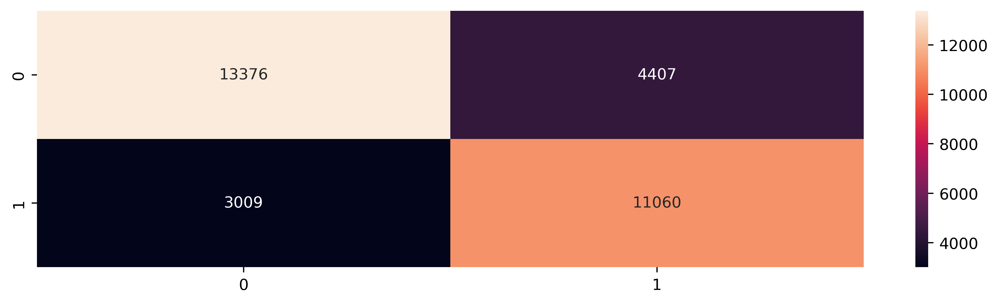

In [195]:
plt.figure(figsize=(12,3),dpi=400)
sns.heatmap(conf,annot=True,fmt='g')

In [196]:
y_hat=pipeline.predict(X_test)

In [197]:
conf=confusion_matrix(y_test,y_hat)
conf

array([[13402,  4381],
       [ 3050, 11019]], dtype=int64)

<Axes: >

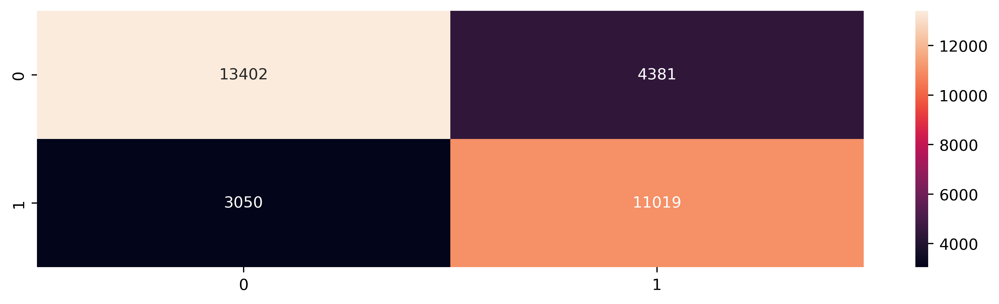

In [198]:
plt.figure(figsize=(12,3),dpi=400)
sns.heatmap(conf,annot=True,fmt='g')

In [199]:
print(classification_report(y_test,y_hat))
print(roc_auc_score(y_test,y_hat))

              precision    recall  f1-score   support

           0       0.81      0.75      0.78     17783
           1       0.72      0.78      0.75     14069

    accuracy                           0.77     31852
   macro avg       0.77      0.77      0.77     31852
weighted avg       0.77      0.77      0.77     31852

0.7684262167900753


In [200]:
fpr = {}
tpr = {}
roc_auc = {}
fpr, tpr,_= roc_curve(y_test,y_hat)
roc_auc= auc(fpr, tpr)

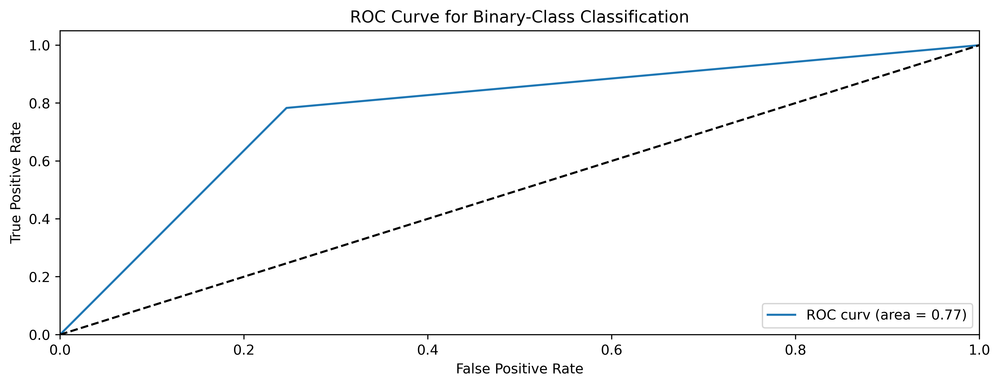

In [201]:
plt.figure(figsize=(12,4),dpi=500)
plt.plot(fpr, tpr, label=f'ROC curv (area = {roc_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--')  
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Binary-Class Classification')
plt.legend(loc="lower right")
plt.show()

In [202]:
from sklearn.metrics import precision_recall_curve,average_precision_score

In [203]:
precision = {}
recall = {}
average_precision = {}
for i in range(4):
    precision, recall,_= precision_recall_curve(y_test,y_hat)
    average_precision = average_precision_score(y_test,y_hat,average='macro')

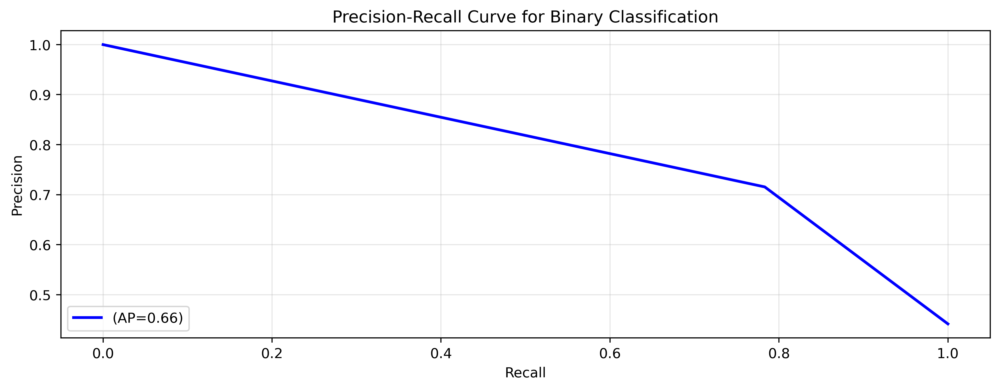

In [204]:
plt.figure(figsize=(12,4),dpi=400)
plt.plot(recall, precision, color='blue', lw=2, label=f'(AP={average_precision:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve for Binary Classification')
plt.legend(loc='lower left')
plt.grid(alpha=0.3)
plt.show()

## USING DIFFERENT MODELS

In [205]:
models = [LinearRegression,LogisticRegression,xgb.XGBClassifier,lgb.LGBMClassifier,xgb.XGBRegressor,GradientBoostingClassifier]

In [206]:
for i in models:
    pipeline1=Pipeline([
    ("Pipeline",inner),
    ("model",i())
    ])
    pipeline1.fit(X_train,y_train)
    y_hat1=pipeline1.predict(X_test)
    y_hat_binary1= (y_hat1>= 0.5).astype(int)
    print(classification_report(y_test,y_hat_binary1))
    print(roc_auc_score(y_test,y_hat_binary1))

              precision    recall  f1-score   support

           0       0.78      0.76      0.77     17783
           1       0.71      0.73      0.72     14069

    accuracy                           0.75     31852
   macro avg       0.75      0.75      0.75     31852
weighted avg       0.75      0.75      0.75     31852

0.749085120747522
              precision    recall  f1-score   support

           0       0.78      0.77      0.78     17783
           1       0.71      0.72      0.72     14069

    accuracy                           0.75     31852
   macro avg       0.75      0.75      0.75     31852
weighted avg       0.75      0.75      0.75     31852

0.746354511383107
              precision    recall  f1-score   support

           0       0.82      0.76      0.79     17783
           1       0.72      0.78      0.75     14069

    accuracy                           0.77     31852
   macro avg       0.77      0.77      0.77     31852
weighted avg       0.77      0.77     

<h4 style="color:#333333;""><span style="background-color: #e6e6fa; display: inline-block; padding: 5px;"">The Accuracy didn't surpass 77 %</span></h4>   

- Best Model
  - RandomForestClassifier (77%)
  - LGBMClassifier (77%)

## Hyper_parameter Tuning For Random Forest Classifier

In [80]:
oob_score = pipeline.named_steps['model'].oob_score_

In [81]:
oob_score

0.7687042793004929

In [82]:
from sklearn.model_selection import GridSearchCV

In [83]:
RandomForestClassifier()

RandomForestClassifier()

In [84]:
param_grid=[{
    'model__n_estimators':[50,100,150,200],
    'model__criterion':["gini", "entropy", "log_loss"],
    'model__max_features':["sqrt", "log2", None],
}]

In [ ]:
grid_search=GridSearchCV(pipeline,param_grid,cv=2,scoring='neg_root_mean_squared_error')

In [ ]:
grid_search.fit(X_train,y_train)

In [ ]:
grid_search.best_params_

In [ ]:
from sklearn.metrics import roc_curve,roc_auc_score,auc

In [ ]:
roc_auc_score(y_test,y_hat_binary)

In [ ]:
roc_curve(y_test,y_hat_binary)

In [ ]:
fpr = {}
tpr = {}
roc_auc = {}
fpr, tpr,_= roc_curve(y_test,y_hat_binary)
roc_auc= auc(fpr, tpr)


In [ ]:

plt.figure()
plt.plot(fpr, tpr, label=f'ROC curv (area = {roc_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--')  
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Multi-Class Classification')
plt.legend(loc="lower right")
plt.show()

## FINDING THE MOST IMPORTANT FEATURES FOR THE PROBLEM 

In [207]:
name=pipeline.feature_names_in_

In [208]:
importances = pipeline.named_steps['model'].feature_importances_
print(importances)

[0.03898333 0.00322713 0.05693532 0.06461349 0.00495633 0.05179511
 0.05808229 0.11584482 0.05355227 0.0503132  0.06373933 0.0955997
 0.06623402 0.15448004 0.0592034  0.00866782 0.00812386 0.00705396
 0.00560758 0.01190094 0.00787173 0.00338339 0.00777466 0.00205627]


In [209]:
sorted(zip(importances.round(2),name),reverse=True)

[(0.15, 'HDL'),
 (0.12, 'hearing_right'),
 (0.1, 'Cholesterol'),
 (0.07, 'triglyceride'),
 (0.06, 'weight_kg'),
 (0.06, 'waist_cm'),
 (0.06, 'hearing_left'),
 (0.06, 'fasting_blood_sugar'),
 (0.06, 'LDL'),
 (0.05, 'systolic'),
 (0.05, 'relaxation'),
 (0.05, 'eyesight_right'),
 (0.04, 'age'),
 (0.01, 'serum_creatinine'),
 (0.01, 'hemoglobin'),
 (0.01, 'Urine_protein'),
 (0.01, 'Gtp'),
 (0.01, 'BMI'),
 (0.01, 'AST'),
 (0.01, 'ALT'),
 (0.0, 'height_cm'),
 (0.0, 'eyesight_left'),
 (0.0, 'eyesight'),
 (0.0, 'dental_caries')]

## Using Predict Proba function instead of predict function in Logistic Regression and LGBMClassifier 

In [210]:
new_train.shape

(159256, 24)

#### TRYING A SIMPLE APPROACH TO CHECK WHETHER AN ACCURAY CHANGES OR NOT 

In [211]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import lightgbm as lgb
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn.compose import ColumnTransformer,make_column_transformer
from sklearn.preprocessing import OneHotEncoder,StandardScaler,FunctionTransformer,OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.metrics import confusion_matrix,classification_report,roc_curve,roc_auc_score,auc

In [212]:
new_train.columns

Index(['id', 'age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left',
       'eyesight_right', 'hearing_left', 'hearing_right', 'systolic',
       'relaxation', 'fasting_blood_sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine_protein', 'serum_creatinine', 'AST',
       'ALT', 'Gtp', 'dental_caries', 'smoking'],
      dtype='object')

In [213]:
X = new_train.drop(columns=['smoking','id'])
y = new_train['smoking']

In [214]:
num_val=X.columns
num_val

Index(['age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left',
       'eyesight_right', 'hearing_left', 'hearing_right', 'systolic',
       'relaxation', 'fasting_blood_sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine_protein', 'serum_creatinine', 'AST',
       'ALT', 'Gtp', 'dental_caries'],
      dtype='object')

In [215]:
pipe_num_without_outlier=make_pipeline(
    StandardScaler()
)

In [216]:
inner=ColumnTransformer([
    ("Num_val",pipe_num_without_outlier,num_val),
])

In [217]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [218]:
lr=Pipeline([
    ("Pipeline",inner),
    ("model",LogisticRegression(solver='liblinear', multi_class='ovr'))

])
lr

Pipeline(steps=[('Pipeline',
                 ColumnTransformer(transformers=[('Num_val',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  Index(['age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left',
       'eyesight_right', 'hearing_left', 'hearing_right', 'systolic',
       'relaxation', 'fasting_blood_sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine_protein', 'serum_creatinine', 'AST',
       'ALT', 'Gtp', 'dental_caries'],
      dtype='object'))])),
                ('model',
                 LogisticRegression(multi_class='ovr', solver='liblinear'))])

In [219]:
lr.fit(X_train, y_train)

Pipeline(steps=[('Pipeline',
                 ColumnTransformer(transformers=[('Num_val',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  Index(['age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left',
       'eyesight_right', 'hearing_left', 'hearing_right', 'systolic',
       'relaxation', 'fasting_blood_sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine_protein', 'serum_creatinine', 'AST',
       'ALT', 'Gtp', 'dental_caries'],
      dtype='object'))])),
                ('model',
                 LogisticRegression(multi_class='ovr', solver='liblinear'))])

In [220]:
preds = lr.predict_proba(X_test)

In [221]:
preds

array([[0.93978797, 0.06021203],
       [0.47236054, 0.52763946],
       [0.47277868, 0.52722132],
       ...,
       [0.90357957, 0.09642043],
       [0.58211516, 0.41788484],
       [0.56979492, 0.43020508]])

In [222]:
from sklearn.metrics import roc_curve, roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, preds[:,1])
auc = roc_auc_score(y_test,preds[:,1])
print(auc)

0.8354573629933739


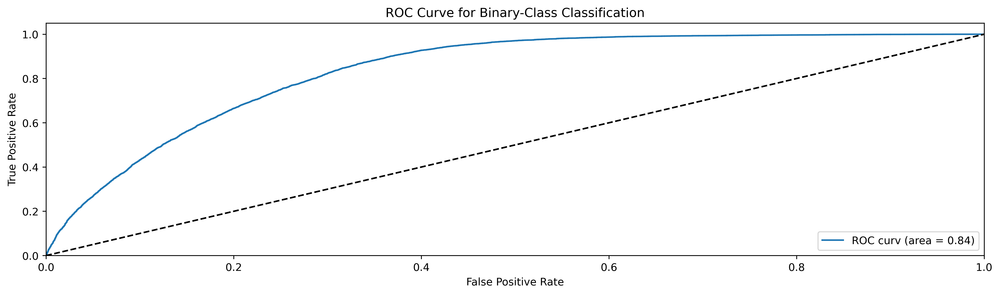

In [223]:
plt.figure(figsize=(16,4),dpi=400)
plt.plot(fpr, tpr, label=f'ROC curv (area = {auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--')  
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Binary-Class Classification')
plt.legend(loc="lower right")
plt.show()

In [224]:
lr=Pipeline([
    ("Pipeline",inner),
    ("model",lgb.LGBMClassifier(num_leaves=128,min_child_samples=10,min_sum_hessian_in_leaf=1,feature_fraction=1.0,bagging_fraction=1.0)
)
])
lr

Pipeline(steps=[('Pipeline',
                 ColumnTransformer(transformers=[('Num_val',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  Index(['age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left',
       'eyesight_right', 'hearing_left', 'hearing_right', 'systolic',
       'relaxation', 'fasting_blood_sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine_protein', 'serum_creatinine', 'AST',
       'ALT', 'Gtp', 'dental_caries'],
      dtype='object'))])),
                ('model',
                 LGBMClassifier(bagging_fraction=1.0, feature_fraction=1.0,
                                min_child_samples=10, min_sum_hessian_in_leaf=1,
                                num_leaves=128))])

In [225]:
lr.fit(X_train, y_train)
preds = lr.predict_proba(X_test)

[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=1, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=1
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=1, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=1
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Info] Number of positive: 55483, number of negative: 71921
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027664 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [I

In [226]:
from sklearn.metrics import roc_curve, roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, preds[:,1])
auc = roc_auc_score(y_test,preds[:,1])
print(auc)

0.8667604548545516


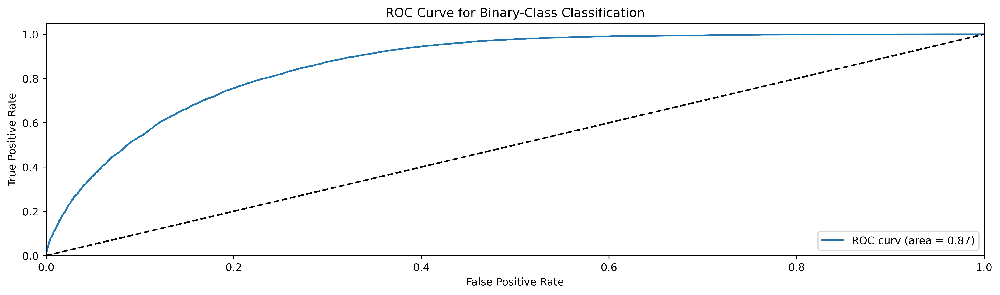

In [227]:
plt.figure(figsize=(16,4),dpi=400)
plt.plot(fpr, tpr, label=f'ROC curv (area = {auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--')  
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Binary-Class Classification')
plt.legend(loc="lower right")
plt.show()

# TEST

In [248]:
test=pd.read_csv("Binary Prediction of Smoker Status using Bio-Signals/test.csv")

In [249]:
test.head()

,id,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,triglyceride,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries
0,159256,40,165,70,84.0,1.2,1.2,1,1,130,...,186,49,115,14.2,1,0.9,19,25,32,0
1,159257,80,160,60,93.0,1.0,1.0,2,2,144,...,158,35,104,13.0,1,1.1,20,12,24,0
2,159258,60,170,70,86.5,0.6,0.7,1,1,117,...,173,39,88,15.4,1,1.4,38,60,36,0
3,159259,40,160,50,67.0,0.3,0.4,1,1,116,...,47,75,128,14.5,1,0.6,25,18,10,1
4,159260,40,170,75,89.4,1.0,0.9,1,1,132,...,100,39,123,16.5,1,1.0,30,39,27,1


In [250]:
new_df=test.copy()

In [251]:
col_name={
    "height(cm)":"height_cm",
    "weight(kg)":"weight_kg",
    "waist(cm)":"waist_cm",
    "eyesight(right)":"eyesight_right",
    "eyesight(left)":"eyesight_left",
    "hearing(right)":"hearing_right",
    "hearing(left)":"hearing_left"
}

In [252]:
## Putting _ in 4 col
test.rename(columns=col_name,inplace=True)
test.rename(columns=col_rename,inplace=True)

In [253]:
test.drop("id",axis=1,inplace=True)

In [254]:
y_hat=lr.predict_proba(test)

[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=1, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=1
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0


In [255]:
output = pd.DataFrame({'id': new_df.id, 'NObeyesdad':y_hat[:,1]})
output.to_csv('Multi-Class Prediction of Obesity Risk.csv', index=False)
print("Your submission was successfully saved!")

Your submission was successfully saved!


## Model Persistence

In [256]:
import joblib

In [257]:
joblib.dump(lr,"model.joblib")

['model.joblib']

In [258]:
saved_model=joblib.load("model.joblib")
saved_model

Pipeline(steps=[('Pipeline',
                 ColumnTransformer(transformers=[('Num_val',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  Index(['age', 'height_cm', 'weight_kg', 'waist_cm', 'eyesight_left',
       'eyesight_right', 'hearing_left', 'hearing_right', 'systolic',
       'relaxation', 'fasting_blood_sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine_protein', 'serum_creatinine', 'AST',
       'ALT', 'Gtp', 'dental_caries'],
      dtype='object'))])),
                ('model',
                 LGBMClassifier(bagging_fraction=1.0, feature_fraction=1.0,
                                min_child_samples=10, min_sum_hessian_in_leaf=1,
                                num_leaves=128))])

In [259]:
y_pred=saved_model.predict(X_test)

[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=1, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=1
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0


In [260]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.83      0.76      0.79     17682
           1       0.73      0.81      0.77     14170

    accuracy                           0.78     31852
   macro avg       0.78      0.78      0.78     31852
weighted avg       0.79      0.78      0.78     31852



In [261]:
roc_auc_score(y_test, y_pred)

0.7841041573722608